In [135]:
#1D non-isothermal
#I think we should still convert it to molar flowrates somehow!!!

'''To do for thursday meeting
 - NEED TO REDO THE A/V CALCULATION
 - Fix heating term (first inlet and then furnace)
'''

from scipy.integrate import solve_ivp
import numpy as np
import matplotlib.pyplot as plt

In [136]:
def heats(T):
    #heats of reaction and heat capacity calculation from NIST
    t = T/1000

    #CH4
    A =	-0.703029
    B =	108.4773
    C =	-42.52157
    D =	5.862788
    E =	0.678565
    F =	-76.84376
    G =	158.7163
    H =	-74.87310

    dH_CH4 = A*t + B*t**2/2 + C*t**3/3 + D*t**4/4 - E/t + F - H
    Cp_CH4 = A + B*t + C*t**2 + D*t**3 + E/(t**2)

    #H2O
    A =   30.09200
    B =   6.832514
    C =   6.793435
    D =  -2.534480
    E =   0.082139
    F =  -250.8810
    G =   223.3967
    H =  -241.8264

    dH_H2O = A*t + B*t**2/2 + C*t**3/3 + D*t**4/4 - E/t + F - H
    Cp_H2O = A + B*t + C*t**2 + D*t**3 + E/(t**2)

    #CO
    A =   25.56759
    B =   6.096130
    C =   4.054656
    D =  -2.671301
    E =   0.131021
    F =  -118.0089
    G =   227.3665
    H = -110.5271

    dH_CO = A*t + B*t**2/2 + C*t**3/3 + D*t**4/4 - E/t + F - H
    Cp_CO = A + B*t + C*t**2 + D*t**3 + E/(t**2)

    #CO2
    A =   24.99735
    B =   55.18696
    C =  -33.69137
    D =   7.948387
    E =  -0.136638
    F =  -403.6075
    G =   228.2431
    H =  -393.5224

    dH_CO2 = A*t + B*t**2/2 + C*t**3/3 + D*t**4/4 - E/t + F - H
    Cp_CO2 = A + B*t + C*t**2 + D*t**3 + E/(t**2)

    #H2
    A =  33.066178
    B = -11.363417
    C =  11.432816
    D = -2.772874
    E = -0.158558
    F = -9.980797
    G =  172.707974
    H =  0.0

    dH_H2 = A*t + B*t**2/2 + C*t**3/3 + D*t**4/4 - E/t + F - H
    Cp_H2 = A + B*t + C*t**2 + D*t**3 + E/(t**2)

    #Ar
    A =	20.78600
    B =	2.825911*10**-7
    C =	-1.464191*10**-7
    D =	1.092131*10**-8
    E =	-3.661371*10**-8
    F =	-6.197350
    G =	179.9990
    H =	0

    Cp_Ar = A + B*t + C*t**2 + D*t**3 + E/(t**2) #J/mol K

    dHsmr = (3*dH_H2 + dH_CO - dH_CH4 - dH_H2O + 206.1)*10**3 #J/mol
    dHwgs = (dH_H2 + dH_CO2 - dH_CO - dH_H2O - 41.15)*10**3 #J/mol
    # print(dHsmr)
    # print(dHwgs)
    # print([Cp_CH4, Cp_H2O, Cp_CO, Cp_CO2, Cp_H2])
    return dHsmr, dHwgs, [Cp_CH4, Cp_H2O, Cp_CO, Cp_CO2, Cp_H2, Cp_Ar]

In [137]:
#WANT TO RE-ARANGE CONSTANTS

#reactor constants
L = 0.0609 #m
R_inner = 2.39/1000 #m
R_outer = 3.5/1000 #m

A = np.pi * ((R_outer)**2-(R_inner)**2) #m^2 AXIAL AREA (GAS FLOW)
V = A*L #m^3
S = 2*np.pi*R_outer*L #m^2 RADIAL AREA (HEAT FLUX AND REACTION)

# HYDROGEN REMOVAL DISABLED h2Removal = 0 #change to 1 if there is removal of hydrogen

#gas flow constants WHEN CHANGING THE TEMPERATURE YOU NEED TO ADJUST THE INITIAL GUESS -- USING ODEINT MIGHT BE FOR BETTER CONVERSION
Tin = 622+273 #K
P = 1 #bar or atm

sccm0 = np.array([16.16, 48.48, 0, 0, 10, 5])
mols0 = sccm0/22400 * 60
boundary = np.concatenate((mols0, [Tin]))
print(boundary)

#rate equation constants
Rgas = 8.314 #J / mol·K
Easmr = 165.740 #kJ/mol
Asmr = 1.68*10**8
Eawgs = 89.23 #kJ/mol
Awgs = 9.90*10**3

Ku = 1

I = 9 #curent in Amps
Fara = 96485 #faradays constant

U = 0.116 #J (s K)^-1.
Ts = 298 #K

q_furn= 0

[4.32857143e-02 1.29857143e-01 0.00000000e+00 0.00000000e+00
 2.67857143e-02 1.33928571e-02 8.95000000e+02]


In [ ]:
nz = 20

z = np.linspace(0,L,nz)
dz = L / (nz - 1)

#initial guess array
u_init = np.zeros((6, len(z)))
u_init[1,:] = 0.13
u_init[5,:] = 0.013

u_init = u_init.flatten()

T = Tin

def pde(z, F):
    F = F.reshape((6, nz))
    dFdt = np.zeros_like(F)
    dFdz = np.zeros_like(F)
    rsmr = np.zeros_like(F[0])
    rwgs = np.zeros_like(F[0])

    F[:6,0] = mols0[:6]
  
    y = F[:6,:]/np.sum(F[:6,:], axis = 0)

    Keqsmr = (101325/100000)**2 * np.exp(-26830/T + 30.114)
    Keqwgs = np.exp(4400/T - 4.036)
    rsmr[1:] = S/V*Ku*Asmr*np.exp(-Easmr*1000/Rgas/T)*(y[0,1:]*y[1,1:]-(P**2)*y[2,1:]*(y[4,1:]**3)/Keqsmr)
    rwgs[1:] = S/V*Ku*Awgs*np.exp(-Eawgs*1000/Rgas/T)*(y[1,1:]*y[2,1:]-y[3,1:]*y[4,1:]/Keqwgs)
    print('react')
    print(rsmr)

    dFdz[:6,1:] = (F[:6,1:] - F[:6,:-1])/dz

    dFdt[0,:] = -dFdz[0, :]/A + (- rsmr)
    dFdt[1,:] = -dFdz[1, :]/A + (- rsmr - rwgs)
    dFdt[2,:] = -dFdz[2, :]/A + (rsmr - rwgs)
    dFdt[3,:] = -dFdz[3, :]/A + (rwgs)
    dFdt[4,:] = -dFdz[4, :]/A + (3*rsmr + rwgs)
    dFdt[5,:] = -dFdz[5, :]/A
    print(dFdt[0,:])

    #velocity calculation you then only need for temperature

    return dFdt.flatten()

t_final = 0.1
t_span = (0, t_final)  # Time interval
t_eval = np.linspace(0, t_final, 10)  # Time evaluation points

sol = solve_ivp(pde, t_span, u_init, method='RK45', t_eval=t_eval)

react
[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[    -0.         657495.44814176     -0.             -0.
     -0.             -0.             -0.             -0.
     -0.             -0.             -0.             -0.
     -0.             -0.             -0.             -0.
     -0.             -0.             -0.             -0.        ]
react
[0.        0.0128383 0.        0.        0.        0.        0.
 0.        0.        0.        0.        0.        0.        0.
 0.        0.        0.        0.        0.        0.       ]
[    -0.         656690.56417582    804.87112763     -0.
     -0.             -0.             -0.             -0.
     -0.             -0.             -0.             -0.
     -0.             -0.             -0.             -0.
     -0.             -0.             -0.             -0.        ]
react
[0.         0.25098867 0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0

KeyboardInterrupt: 

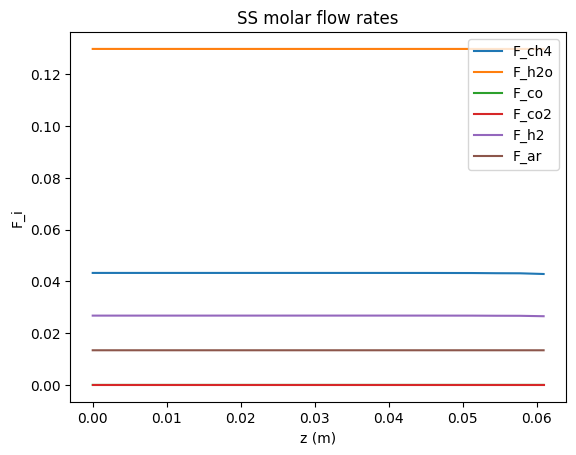

In [ ]:
plot_SSsol = sol.y[:, -1].reshape((6, nz)) #the -1 refers to the last time
plt.plot(z, plot_SSsol[0], label='F_ch4')
plt.plot(z, plot_SSsol[1], label='F_h2o')
plt.plot(z, plot_SSsol[2], label='F_co')
plt.plot(z, plot_SSsol[3], label='F_co2')
plt.plot(z, plot_SSsol[4], label='F_h2')
plt.plot(z, plot_SSsol[5], label='F_ar')
plt.xlabel('z (m)')
plt.ylabel('F_i')
plt.title('SS molar flow rates')
plt.legend()

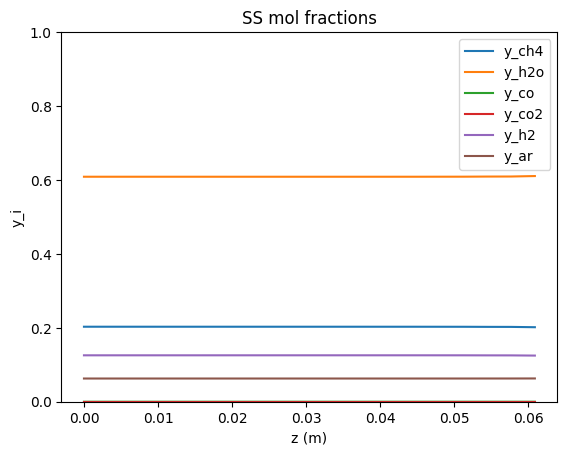

In [ ]:
y = plot_SSsol[:6]/np.sum(plot_SSsol[:6], axis = 0)
plt.plot(z, y[0], label='y_ch4')
plt.plot(z, y[1], label='y_h2o')
plt.plot(z, y[2], label='y_co')
plt.plot(z, y[3], label='y_co2')
plt.plot(z, y[4], label='y_h2')
plt.plot(z, y[5], label='y_ar')
plt.ylim(0, 1)
plt.xlabel('z (m)')
plt.ylabel('y_i')
plt.title('SS mol fractions')
plt.legend()

Text(0.5, 1.0, 'Temperature profile')

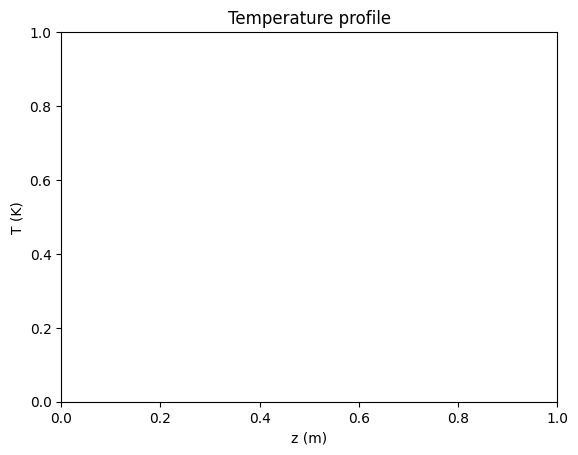

In [ ]:
#plt.plot(soln.x, soln.y[6])
plt.xlabel('z (m)')
plt.ylabel('T (K)')
plt.title('Temperature profile')

ValueError: shape mismatch: objects cannot be broadcast to a single shape.  Mismatch is between arg 0 with shape (6,) and arg 1 with shape (6, 20).

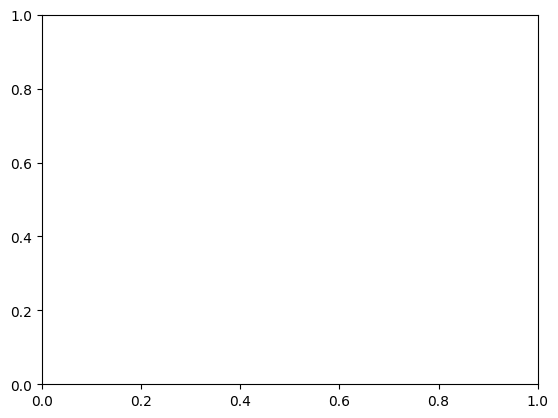

In [ ]:
# Assign experimental data based on temperature
if Tin == 622 + 273:
    yexp = [0.071787506, 0.298008466, 0.043658696, 0.043658696, 0.495104008, 0.047782628]
elif Tin == 721 + 273:
    yexp = [0.019206098, 0.189598069, 0.090570208, 0.034350264, 0.619497555, 0.046777807]
elif Tin == 573 + 273:
    yexp = [0.101830373, 0.416886827, 0.02267593, 0.043676434, 0.365008486, 0.04992194]
elif Tin == 522 + 273:
    yexp = [0.135048125, 0.331577273, 0.010516725, 0.034486466, 0.436794105, 0.051577306]
else:
    print('Sorry, we don’t have experimental data for that temperature.')
    yexp = [0, 0, 0, 0, 0, 0]


# Define categories
categories = ['ych4', 'yh2o', 'yco', 'yco2', 'yh2', 'yar']
x = np.arange(len(categories))  # the label locations
width = 0.35  # the width of the bars

# Plot
fig, ax = plt.subplots()
bars1 = ax.bar(x - width/2, y[:6], width, label='Model')
bars2 = ax.bar(x + width/2, yexp, width, label='Experimental')

# Labels and legend
ax.set_ylabel('y_i')
ax.set_title(f'Accuracy of model at {Tin}K or {Tin - 273}°C')
ax.set_xticks(x)
ax.set_xticklabels(categories)
ax.legend()

plt.tight_layout()
plt.show()

print(np.sum(y[:6]))